In [1]:
import numpy as np
import random 
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import mpl_toolkits.mplot3d.axes3d as p3

import subprocess 


**INTERNAL UNITS**

nbody_sh1 works with internal units. $G_{iu}$ is set equal to 1. We are free to express masses and distances in arbitrary units, as far as velocities and times are consistent. In order to see that, notice that $\frac{GM}{rv^2}$ is adimensional. 

$$\frac{M_{iu}}{r_{iu}v_{iu}^2}=\frac{G_{cgs}M_{cgs}}{r_{cgs}v_{cgs}^2}$$

Velocities in internal units will be related to physical velocities by:

$$v_{iu}=\sqrt{\frac{r_{cgs}}{G_{cgs}M_{cgs}}}v_{cgs}$$

We need to tranform time units in internal units as well. $\frac{rt}{v}$ is adimensional. 

$$\frac{t_{iu}v_{iu}}{r_{iu}}=\frac{t_{cgs}v_{cgs}}{r_{cgs}}$$

$$t_{iu}=\frac{r_{iu}}{r_{cgs}}\sqrt{\frac{r_{cgs}}{G_{cgs}M_{cgs}}}t_{cgs}$$

In [2]:
G_cgs = 6.67259 * 10**-8 #G in cgs
M_sun = 1.9891 * 10**33 #solar mass in g
R_sun = 6.9598 * 10**10 #solar radius in cm 
M_earth = 5.976 * 10**27 #earth mass in g
R_earth = 6.378 * 10**8 #earth radius in cm
ly = 9.463 * 10**17 #light year in cm
parsec = 3.086 * 10**18 #parsec in cm
AU = 1.496 * 10**13 #astronomical unit in cm

def v_IU(M_cgs, r_cgs, v_cgs):
    return np.sqrt(r_cgs/(G_cgs*M_cgs))*v_cgs

def t_IU(M_cgs, r_cgs, t_cgs):
    return t_cgs/(np.sqrt(r_cgs/(G_cgs*M_cgs))*r_cgs)

print("We choose 1 solar mass as mass unit and 1 parsec unit as distance unit.")
print("200 km/s expressed in internal units is: %f" % (v_IU(M_sun,parsec,26.22*10**5)))
print("1 Myr expressed in internal units is: %f" % (t_IU(M_sun,parsec,3.156*10**13)))
print("1 time unit expressed in cgs is: %f Myrs" % (t_IU(M_sun,parsec,3.156*10**13)))

We choose 1 solar mass as mass unit and 1 parsec unit as distance unit.
200 km/s expressed in internal units is: 399.811350
1 Myr expressed in internal units is: 0.067069
1 time unit expressed in cgs is: 0.067069 Myrs


**GENERATING AN HOMOGENEUS SPHERE**

$$dV = (r^2 dr)(\sin\theta d\theta)(d \phi)$$

$$p(r) = \frac{1}{M} 4 \pi r^2 \rho_0 $$

$$P(r) =  \int_0^r p(r) dr = \frac{4\pi \rho_0}{3M} r^3   $$
 
$$\int_0^R p(r) dr = 1$$

$$r(P) = \left(\frac{3MP}{4\pi \rho_0}\right)^{1/3}$$

$$p(\theta) = \frac{\sin\theta}{2}$$

$$P(\theta) = \int_0^\theta p(\theta) = \frac{-\cos\theta+1}{2}$$

$$\theta(P)=\arccos(1-2P)$$

$$\int_0^\pi p(\theta) = 1$$

$$p(\phi) = \frac{1}{2\pi}$$

$$P(\phi) = \frac{\phi}{2\pi}$$

$$\phi(P) = 2\pi P $$

In [3]:
class Star:
    def __init__(self, m, x, v): #x is the cartesian coordinate vector, v the cartesian velocity
        self.m = m
        self.position = np.array(x)
        self.velocity = np.array(v)
        self.kinetic_energy = (0.5)*self.m*(v[0]**2+v[1]**2+v[2]**2)
 
class Homogeneus_Galaxy:
    def __init__(self, N, rho, m): #N is the number of stars, rho is the density, m the single star mass
        self.N = int(N)
        self.rho = rho
        self.m = m
        self.M = N*m
        self.R = (3*self.M/(4*np.pi*rho))**(1/3)
        print("Galaxy of %i stars of mass %f. Density is %f solar masses for parsec cube, radius is %f parsecs, total mass %f solar masses" %(self.N, self.m, self.rho, self.R, self.M))
        
        #random population of our homogeneus galaxy
        points_pol=[] #polar coordinates of points
        points_cart=[] #cartesian coordinates of the points
        stars=[] #stars
        self.colors=[] #colors of stars
        for i in range(self.N):
            u = random.uniform(0,1) #no need to pass seed to random method. By default the random number generator uses the current system time
            v = random.uniform(0,1)
            w = random.uniform(0,1)
            points_pol.append([(3*self.M*u/(4*np.pi*rho))**(1/3),np.arccos(1-2*v),2*np.pi*w])  
        r = np.array(points_pol)[:,0]
        
        for point in points_pol:
            points_cart.append([point[0]*np.sin(point[1])*np.cos(point[2]),point[0]*np.sin(point[1])*np.sin(point[2]),point[0]*np.cos(point[1])])
        for i in range(len(points_cart)):
            stars.append(Star(self.m, points_cart[i], [0,0,0]))
            if r[i]<self.R/4:
                self.colors.append("red")
            elif r[i]>=self.R/4 and r[i]<self.R/2:
                self.colors.append("orange")
            elif r[i]>=self.R/2 and r[i]<3*self.R/4:
                self.colors.append("green")
            else:
                self.colors.append("b")
        self.star_collection = np.array(stars)

        #writes initial conditions in file for nbody_sh1
        initial_conditions = open("initial_conditions.in", "w") 
        initial_conditions.write(str(self.N)+"\n")
        initial_conditions.write(str(0)+"\n")
        for star in self.star_collection: 
            initial_conditions.write(str(self.m)+"\t"+str(star.position[0])+"\t"+str(star.position[1])+"\t"+str(star.position[2])+"\t"+str(star.velocity[0])+"\t"+str(star.velocity[1])+"\t"+str(star.velocity[2])+"\n")
        initial_conditions.close()

        #writes free fall time
        self.free_fall_time = np.sqrt(3*np.pi/(32*self.rho))
        print("Free fall time is %f in internal units, %f Myr" %(self.free_fall_time, self.free_fall_time*0.067069))
        print("Run:  ./nbody_sh1 -d 0.03 -e 1.0 -o 0.01 -t %f < initial_conditions.in > output.out  to cover at least 1 free fall time." %self.free_fall_time)


    def plot_galaxy_time_zero(self):
        fig = plt.figure(figsize=(20, 20))
        ax = fig.add_subplot(projection='3d')
        ax.scatter([x.position[0] for x in self.star_collection], [x.position[1] for x in self.star_collection], [x.position[2] for x in self.star_collection], color=self.colors)
        ax.set_xlim(-self.R, self.R)
        ax.set_ylim(-self.R, self.R)
        ax.set_zlim(-self.R, self.R)
        ax.set_title('Homogeneus galaxy at time 0')
        ax.set_xlabel('X [parsec]')
        ax.set_ylabel('Y [parsec]')
        ax.set_zlabel('Z [parsec]')
        plt.show()

    def collapse_animation(self, speed): 
        print("ATTENTION: BE SURE NBODY_SH1 HAS RUN AFTER EACH CLASS ISTANCE")
        #opens the output file and writes star's positions array for each time t in a list
        output = open("output.out", "r").readlines()
        t=[]
        evolution_star_collections = [] #list of star_collections, one for each time
        for i in range(int(len(output)/(self.N+2))):
            t.append(float(output[i*(self.N+2)+1])) #time in internal units
            star_collection = []
            for j in range(self.N): 
                star_collection.append(Star(self.m, [float(output[i*(self.N+2)+(2+j)].split()[1]),float(output[i*(self.N+2)+(2+j)].split()[2]),float(output[i*(self.N+2)+(2+j)].split()[3])], [float(output[i*(self.N+2)+(2+j)].split()[4]),float(output[i*(self.N+2)+(2+j)].split()[5]),float(output[i*(self.N+2)+(2+j)].split()[6])]))
            evolution_star_collections.append(star_collection)

        #############################
        #print(t)
        #print(evolution_star_collections)
        ##############################
        
        #converts list in array, usefull for animation
        #initial frame
        position_of_nth_star = []
        for star in self.star_collection:
                position_of_nth_star.append([star.position[0],star.position[1],star.position[2]])  
        #evolved frames. First frame is the initial one
        positions_at_given_frame = [position_of_nth_star]
        for frame in evolution_star_collections:
            position_of_nth_star = []
            for star in frame:
                position_of_nth_star.append([star.position[0],star.position[1],star.position[2]])
            positions_at_given_frame.append(np.array(position_of_nth_star))
        P = np.array(positions_at_given_frame)
       
        #create figure and set axes
        fig = plt.figure(figsize=(20, 20))
        ax = fig.add_subplot(projection='3d')
        ax.set_xlim3d(-self.R, self.R)
        ax.set_ylim3d(-self.R, self.R)
        ax.set_zlim3d(-self.R, self.R)
        ax.set_xlabel('X [parsec]')
        ax.set_ylabel('Y [parsec]')
        ax.set_zlabel('Z [parsec]')
        # Provide starting angle for the view.
        #ax.view_init(25, 10)

        #PROBLEM HERE
        #plt.title('t = %d Myr' % 0.) 
        #plt.title("start") #doesn't show!
        scatters = [ ax.scatter(P[0][i,0:1], P[0][i,1:2], P[0][i,2:], color=self.colors[i]) for i in range(self.N) ]
       
        speed_up = int(speed)
        def animate_scatters(frame): 
            for i in range(self.N): 
                scatters[i]._offsets3d = (P[frame*speed_up][i,0:1], P[frame*speed_up][i,1:2], P[frame*speed_up][i,2:])
            plt.title('t = %f Myr, %f free_fall_time' %(t[frame*speed_up]*0.067069, t[frame*speed_up]/self.free_fall_time)) 
            return scatters

        ani=animation.FuncAnimation(fig, animate_scatters, frames=int(len(P)/speed_up)-1, interval=100) 

        #writervideo = animation.FFMpegWriter(fps=60) 
        #ani.save('homologous_collapse.mp4', writer=writervideo) 
        from IPython.display import HTML 
        display(HTML(ani.to_jshtml()))
        plt.close()

    def analytic_homogeneus_sphere_potential(self, r):
        if(r<self.R):
            return -2*np.pi*self.rho*(self.R**2-(1/3)*r**2)
        else:
            return -(4*np.pi*self.rho*self.R**3)/(3*r)

    def plot_analytic_potential(self, range, step):
        r_arr= np.linspace(0, range, int(range/step+1))
        potential=[]
        for r in r_arr:
            potential.append(self.analytic_homogeneus_sphere_potential(r))
        plt.plot(r_arr, potential)
        plt.title("Analytic potential of homogeneus sphere")
        plt.xlabel("r [parsecs]")
        plt.ylabel("potential []")
        plt.show()


    
    def kinetic_energies(self): 
        print("ATTENTION: BE SURE NBODY_SH1 HAS RUN AFTER EACH CLASS ISTANCE")
        #opens the output file and writes star's positions array for each time t in a list
        output = open("output.out", "r").readlines()
        t=[]
        evolution_star_collections = [] #list of star_collections, one for each time
        for i in range(int(len(output)/(self.N+2))):
            t.append(float(output[i*(self.N+2)+1])) #time in internal units
            star_collection = []
            for j in range(self.N): 
                p_x = float(output[i*(self.N+2)+(2+j)].split()[1])
                p_y = float(output[i*(self.N+2)+(2+j)].split()[2])
                p_z = float(output[i*(self.N+2)+(2+j)].split()[3])
                v_x = float(output[i*(self.N+2)+(2+j)].split()[4])
                v_y = float(output[i*(self.N+2)+(2+j)].split()[5])
                v_z = float(output[i*(self.N+2)+(2+j)].split()[6])
                star = Star(self.m, [p_x,p_y,p_z], [v_x,v_y,v_z])
                star_collection.append(star)
                #evolution_kinetic_energies.append(star)
            evolution_star_collections.append(star_collection)


        
        #converts list in array, usefull for animation
        #initial frame
        position_of_nth_star = []
        for star in self.star_collection:
                position_of_nth_star.append([star.position[0],star.position[1],star.position[2]])  
        #evolved frames. First frame is the initial one
        positions_at_given_frame = [position_of_nth_star]
        for frame in evolution_star_collections:
            position_of_nth_star = []
            for star in frame:
                position_of_nth_star.append([star.position[0],star.position[1],star.position[2]])
            positions_at_given_frame.append(np.array(position_of_nth_star))
        P = np.array(positions_at_given_frame)
            




In [30]:
#my_very_big_galaxy = Homogeneus_Galaxy(500,200,0.1)

In [4]:
my_galaxy = Homogeneus_Galaxy(200,1,0.1)


Galaxy of 200 stars of mass 0.100000. Density is 1.000000 solar masses for parsec cube, radius is 1.683890 parsecs, total mass 20.000000 solar masses
Free fall time is 0.542701 in internal units, 0.036398 Myr
Run:  ./nbody_sh1 -d 0.03 -e 1.0 -o 0.01 -t 0.542701 < initial_conditions.in > output.out  to cover at least 1 free fall time.


In [8]:
my_galaxy.collapse_animation(5)

ATTENTION: BE SURE NBODY_SH1 HAS RUN AFTER EACH CLASS ISTANCE


# Density

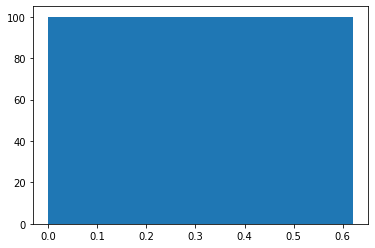

In [17]:
#density = N * m / (4/3 * np.pi * r**3)

#avrebbe senso vedere profilo di densità a t = 0 e poi...

radii = np.linspace(0, my_galaxy.R, 1000)
#print(radii)

for R in radii:
    for r in r_tutti gli r delle nostre part
    
    if (r <= R):
        i = i+1
    density = N * m / (4/3 * np.pi * r**3)


#density = N[r] * m / (4/3 * np.pi * r**3)



In [70]:
my_galaxy = Homogeneus_Galaxy(100,1,0.1)

Galaxy of 100 stars of mass 0.100000. Density is 1.000000 solar masses for parsec cube, radius is 1.336505 parsecs, total mass 10.000000 solar masses
Free fall time is 0.542701 in internal units, 0.036398 Myr
Run:  ./nbody_sh1 -d 0.03 -e 1.0 -o 0.01 -t 0.542701 < initial_conditions.in > output.out  to cover at least 1 free fall time.


In [5]:
my_galaxy.collapse_animation(2)

ATTENTION: BE SURE NBODY_SH1 HAS RUN AFTER EACH CLASS ISTANCE


In [60]:
my_galaxy = Homogeneus_Galaxy(300,1,0.1)

Free fall time is 0.542701 in internal units, 0.036398 Myr
Run:  ./nbody_sh1 -d 0.03 -e 1.0 -o 0.01 -t 0.542701 < initial_conditions.in > output.out  to cover at least 1 free fall time.


In [10]:
my_galaxy.collapse_animation(1)

ATTENTION: BE SURE NBODY_SH1 HAS RUN AFTER EACH CLASS ISTANCE


Animation size has reached 21155921 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [63]:
my_galaxy = Homogeneus_Galaxy(3,100,1)

Free fall time is 0.054270 in internal units, 0.003640 Myr
Run:  ./nbody_sh1 -d 0.03 -e 1.0 -o 0.01 -t 0.054270 < initial_conditions.in > output.out  to cover at least 1 free fall time.


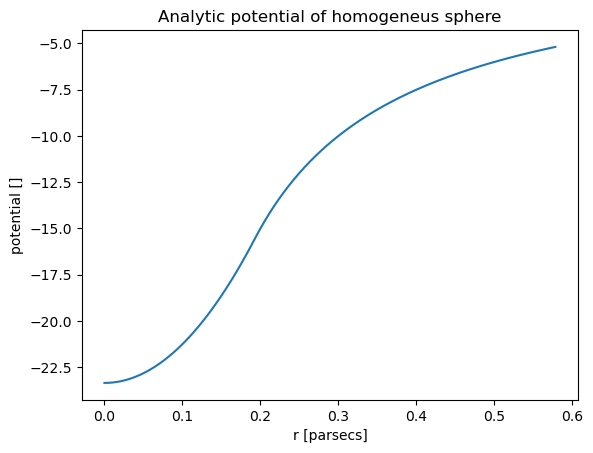

0.19275732104070495


In [65]:
my_galaxy.plot_analytic_potential(3*my_galaxy.R, 0.001)
print(my_galaxy.R)

In [ ]:
import subprocess 
#subprocess.call(["g++", "hello_world.cpp"]) 
tmp=subprocess.call(["./nbody_sh1", "-d", "0.03", "-e", "1.0", "-o", "0.01", "-t", "0.1", "<initial_conditions.in", ">output.out"]) 
print("printing result") 
#print(tmp)
# -d 0.03 -e 1.0 -o 0.01 -t 4 < initial_conditions.in > output.out"

In [ ]:
#animations using plot instead of scatter
        #converts list in array, usefull for animation
        positions_at_given_frame = []
        for frame in evolution_star_collections:
            position_of_nth_star = []
            for star in frame:
                position_of_nth_star.append([star.position[0],star.position[1],star.position[2]])
            positions_at_given_frame.append(position_of_nth_star)
        P = np.array(positions_at_given_frame)
        #takes colours
        c = []
        for star in self.star_collection:
            c.append(star.color)
        #print(c)

        fig = plt.figure(figsize=(10, 10))
        ax = fig.add_subplot(projection='3d')
        ax.set_xlim(-self.R, self.R)
        ax.set_ylim(-self.R, self.R)
        ax.set_zlim(-self.R, self.R)
        ax.set_xlabel('X [AU]')
        ax.set_ylabel('Y [AU]')
        ax.set_zlabel('Z [AU]')
        
        plt.title(f't = %d' % t[0])
        points, = ax.plot(P[0,:,0], P[0,:,1], P[0,:,2], '*',) #, ms=10

        #modifies artist at each frame
        def anim(frame):
            speed_up=5
            #print(t[frame*speed_up])
            points.set_data(P[frame*speed_up,:,0], P[frame*speed_up,:,1])
            points.set_3d_properties(P[frame*speed_up,:,2], 'z')
            plt.title(f't = %d' % (frame*speed_up)) #t[frame*speed_up]
            return points
 
        ani=animation.FuncAnimation(fig, anim, frames=40, interval=100) 
        from IPython.display import HTML
        display(HTML(ani.to_jshtml()))
